## 클러스터링 기반 대표부하 선정


### 데이터 로드

In [1]:
# SAVE 데이터 로드
import os
os.chdir('../')

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from module.util_main import downsampling, dim_reduct
from collections import defaultdict
font = {'size': 16, 'family':"Malgun Gothic"}
matplotlib.rc('font', **font)

from pathlib import Path

### 에너지 데이터 로드
SAVE = pd.read_csv('data/SAVE/power_0428.csv', index_col=0)
SAVE = SAVE.iloc[84:,:]
SAVE.index = pd.to_datetime(SAVE.index)
SAVE[SAVE == 0] = np.nan
SAVE = SAVE.loc[pd.to_datetime('2017-01-01 00:00'):,:]

helper_dict = defaultdict(list)
for col in SAVE.columns:
    helper_dict[col[2:]].append(col)

# 동일 집끼리 병합
drop_cols = []
invalid_idx_list = []
for key,value in helper_dict.items():
    if len(value) >= 2:
        valid_idx_1 = ~pd.isnull(SAVE[value[1]])

        # replace value
        SAVE[value[0]][valid_idx_1] = SAVE[value[1]][valid_idx_1]

        # delete remain
        drop_cols.append(value[1])

# drop cols
SAVE.drop(columns = drop_cols, inplace = True)

# label과 data의 column 맞춤
SAVE.columns = [c[2:] for c in SAVE.columns]

### 라벨 로드
SAVE_label = pd.read_csv('data/SAVE/save_household_survey_data_v0-3.csv', index_col = 0)
# Interviedate가 빠른 순으로 정렬
SAVE_label.sort_values('InterviewDate', inplace = True)
SAVE_label = SAVE_label.T
SAVE_label.columns = SAVE_label.columns.astype(str)

# 라벨 순서를 데이터 순서와 맞춤
valid_col = []
for col in SAVE.columns:
    if col in SAVE_label.columns:
        valid_col.append(col)

SAVE_label = SAVE_label[valid_col].T
SAVE = SAVE[valid_col]
print('Done load SAVE')

# CER 데이터 로드
# %% load dataset
# start_date = pd.to_datetime('2010-09-01 00:00:00')
# end_date = pd.to_datetime('2009-12-01 23:00:00')

power_df = pd.read_csv('data/CER/power_comb_SME_included.csv')

# 0 to NaN
power_df[power_df==0] = np.nan
power_df['time'] = pd.to_datetime(power_df['time'])
power_df.set_index('time', inplace=True)

# load label
CER_label = pd.read_csv('data/CER/survey_processed_0427.csv')
CER_label['ID'] = CER_label['ID'].astype(str)
CER_label.set_index('ID', inplace=True)

CER = power_df.loc[:,CER_label.index]
del power_df
print('Done load CER')

Done load SAVE
Done load CER


In [3]:
## 기간을 6개월 한정
start_date = pd.to_datetime('2018-01-01 00:00:00')
end_date = pd.to_datetime('2018-06-30 23:45:00')

SAVE = SAVE.loc[start_date:end_date,:]

start_date = pd.to_datetime('2010-01-01 00:00:00')
end_date = pd.to_datetime('2010-06-30 23:30:00')

CER = CER.loc[start_date:end_date,:]

In [35]:
# Downsampling
n = SAVE.shape[0]
list_ = []
time_ = []
for i in range(0, n, 2):
    list_.append(SAVE.iloc[i:i+2,:].sum(axis=0))
    time_.append(SAVE.index[i])
list_ = pd.concat(list_, axis=1).T
list_.index = time_
SAVE = list_
del list_

In [36]:
print(SAVE.shape)
print(CER.shape)

(8688, 3934)
(8688, 4232)


NaN 개수 확인

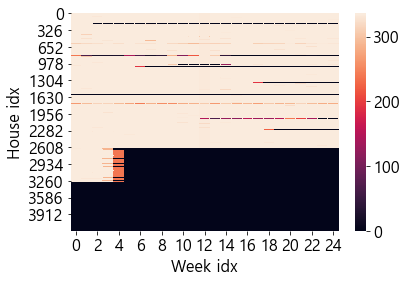

In [59]:
interval = 24 * 2 * 7
n_h = CER.shape[1]
n_d = CER.shape[0]
n_w = n_d // interval
n_d = n_w * interval

valid_points = (~pd.isnull(CER.iloc[:n_d,:].values.T.reshape(n_h, -1, interval))).sum(axis=2)

import seaborn as sns
sns.heatmap(valid_points)
plt.plot('CER')
plt.xlabel('Week idx')
plt.ylabel('House idx')
# plt.xticks([])
# plt.yticks([])
plt.show()

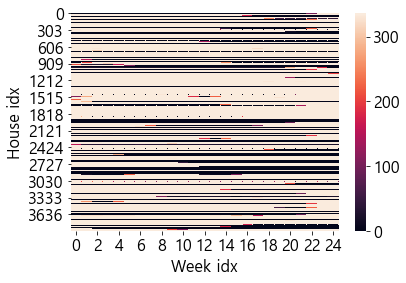

In [61]:
interval = 24 * 2 * 7
n_h = SAVE.shape[1]
n_d = SAVE.shape[0]
n_w = n_d // interval
n_d = n_w * interval

valid_points = (~pd.isnull(SAVE.iloc[:n_d,:].values.T.reshape(n_h, -1, interval))).sum(axis=2)

import seaborn as sns
sns.heatmap(valid_points)
plt.plot('SAVE')
plt.xlabel('Week idx')
plt.ylabel('House idx')
# plt.xticks([])
# plt.yticks([])
plt.show()

집별 nan 수 비율

In [70]:
nan_ratio = pd.isnull(SAVE).sum(axis=0) / SAVE.shape[0]
print(nan_ratio)
print((nan_ratio == 1).sum())

956600034    0.000000
956600058    0.322514
956600128    1.000000
956600237    0.000000
956610449    0.000000
               ...   
956662009    1.000000
956662521    0.725368
956610992    0.564111
956610713    0.000000
956611345    0.000115
Length: 3934, dtype: float64
709


In [72]:
nan_ratio = pd.isnull(CER).sum(axis=0)/ CER.shape[0]
print(nan_ratio)
print((nan_ratio == 1).sum())

ID
1002    0.000460
1003    0.001842
1004    0.000345
1005    0.000230
1008    0.000230
          ...   
7437    1.000000
7440    1.000000
7442    1.000000
7443    1.000000
7444    1.000000
Length: 4232, dtype: float64
984


### nan밖에 업는 집 필터링

In [75]:
nan_ratio = pd.isnull(SAVE).sum(axis=0) / SAVE.shape[0]
invalid_idx = (nan_ratio == 1)
SAVE = SAVE.loc[:,~invalid_idx]
SAVE_label = SAVE_label.loc[~invalid_idx,:]

In [76]:
nan_ratio = pd.isnull(CER).sum(axis=0) / CER.shape[0]
invalid_idx = (nan_ratio == 1)
CER = CER.loc[:,~invalid_idx]
CER_label = CER_label.loc[~invalid_idx,:]

In [77]:
print(SAVE.shape)
print(CER.shape)

(8688, 3225)
(8688, 3248)


## weekly 형태로 변환

In [113]:
def transform(df, sampling_interv = 24 * 2 * 7):
    n_d, n_h = df.shape
    n_w = n_d // sampling_interv
    n_d = n_w * sampling_interv
    df_rs = df.iloc[:n_d,:].values.T.reshape(n_h,-1, sampling_interv)
    return df_rs
SAVE_rs = transform(SAVE, 24 * 2 * 7)
CER_rs = transform(CER, 24 * 2 * 7)

### 2d로 변환 및 nan 데이터 제거

In [114]:
n, m, l = SAVE_rs.shape
SAVE_rs = SAVE_rs.reshape(n*m, l)

In [115]:
home_arr = np.repeat(np.arange(0, n), m)
invalid_idx = np.any(pd.isnull(SAVE_rs), axis=1)
SAVE_rs = SAVE_rs[~invalid_idx, :]
home_arr = home_arr[~invalid_idx]

In [127]:
from tslearn.clustering import TimeSeriesKMeans, KShape
model = TimeSeriesKMeans(n_clusters = 10, metric = 'euclidean', \
        max_iter = 100, random_state = 0, verbose = 1, n_jobs=-1)
result = model.fit_predict(SAVE_rs)

28.591 --> 21.536 --> 21.098 --> 20.973 --> 20.898 --> 20.840 --> 20.800 --> 20.766 --> 20.736 --> 20.710 --> 20.689 --> 20.673 --> 20.660 --> 20.648 --> 20.638 --> 20.628 --> 20.619 --> 20.608 --> 20.598 --> 20.589 --> 20.583 --> 20.576 --> 20.571 --> 20.565 --> 20.561 --> 20.558 --> 20.555 --> 20.554 --> 20.552 --> 20.551 --> 20.550 --> 20.549 --> 20.549 --> 20.548 --> 20.548 --> 20.547 --> 20.547 --> 20.547 --> 20.546 --> 20.546 --> 20.546 --> 20.546 --> 20.545 --> 20.545 --> 20.545 --> 20.544 --> 20.544 --> 20.544 --> 20.544 --> 20.543 --> 20.543 --> 20.543 --> 20.543 --> 20.542 --> 20.542 --> 20.542 --> 20.541 --> 20.541 --> 20.541 --> 20.541 --> 20.540 --> 20.540 --> 20.540 --> 20.540 --> 20.540 --> 20.539 --> 20.539 --> 20.539 --> 20.538 --> 20.538 --> 20.538 --> 20.538 --> 20.537 --> 20.537 --> 20.536 --> 20.536 --> 20.536 --> 20.535 --> 20.535 --> 20.534 --> 20.534 --> 20.534 --> 20.533 --> 20.532 --> 20.532 --> 20.531 --> 20.530 --> 20.529 --> 20.529 --> 20.528 --> 20.527 -->

In [ ]:
# visualize the result
for i in range(10):
    data_ = SAVE_rs[result== i]
    plt.plot(data_.T, color = 'k', alpha = 0.1)
    plt.plot(model.cluster_centers_[i], label = 'centroid')
    plt.title('Cluster {}'.format(i))
    plt.xlabel('Hour')
    plt.ylabel('Energy consumption [kWh]')
    plt.legend()
    plt.show()